# Semantic Relationship with Word Embeddings: MAL Anime Review Dataset

Methods on how to explore smenatic relationship of words using Word Embeddings. Functions referred to Blueprints for Text Analytics by Albrecht et al. (2021) with several adjustments to make it more clear. This notebook will show:

- Gensim library to train different type of embeddings
- Using similarity queries on pretrained models
- Training models from our dataset with Gensim
- Evaluating Different Models
- Applying Dimensionality Reduction
- TensorFlow Embedding Projector

## Basic Concept About Word Embeddings

    Definition

Word embeddings are a type of numerical representation used in natural language processing (NLP) to capture the meaning or semantic relationships between words. They are dense vector representations of words in a high-dimensional space, where each dimension of the vector corresponds to a specific aspect of the word's meaning. The way it works is to assign numbers to words using a Neural Network to create Word Embeddings.

Word embeddings are created by training a model on a large corpus of text, such as a collection of books or articles. During training, the model learns to predict the context in which a word appears. By doing so, it learns to associate similar words with similar vectors in the embedding space.

    Advantages

Word embeddings have proven to be very useful in a wide range of NLP tasks, such as sentiment analysis, machine translation, and named entity recognition. They enable models to capture the meaning and semantic relationships between words, even if they have never seen those specific word pairs during training.

    Disadvantages

- The vectors representing the documents have a large number of dimensions determined by the vocabulary size. As a result, these vectors contain mostly zero values, meaning they are sparse (taking time and space to train)
- It's not a good model to train on a short text like Twitter message

For a clearer explanation on how it works, check: <a href='https://www.youtube.com/watch?v=viZrOnJclY0'>Word Embedding and Word2Vec, Clearly Explained!!!</a> by StatQuest with Josh Starmer

In [389]:
import pandas as pd
import numpy as np
from tqdm import tqdm
from collections import deque

import os

import matplotlib.pyplot as plt
import seaborn as sns

import regex as re
import spacy
import nltk

import gensim.downloader as api
from gensim.models import Word2Vec, FastText, KeyedVectors
from gensim.models.phrases import Phrases, npmi_scorer

import umap.umap_ as UMAP
import plotly.express as px
import networkx as nx
from networkx.drawing.nx_pydot import graphviz_layout 
import pygraphviz

In [24]:
!git clone https://github.com/blueprints-for-text-analytics-python/blueprints-text/tree/master/packages/blueprints.git

Cloning into 'blueprints'...
fatal: repository 'https://github.com/blueprints-for-text-analytics-python/blueprints-text/tree/master/packages/blueprints.git/' not found


## Using Similarity Queries on Pretrained Models

In [37]:
# by setting 'GENSIM_DATA_DIR' to './models', 
# we are indicating that Gensim should look for its data files in the './models' directory relative to the current working directory. 

import os
os.environ['GENSIM_DATA_DIR'] = './models'

    Loading a pretrained model

In default, gensim provides us some pre-trained models using word embeddings that we can take a look into.

In [32]:
import gensim.downloader as api

info_df = pd.DataFrame.from_dict(api.info()['models'], orient='index')
info_df[['file_size', 'base_dataset', 'parameters']]

,file_size,base_dataset,parameters
fasttext-wiki-news-subwords-300,1.005007e+09,"Wikipedia 2017, UMBC webbase corpus and statmt...",{'dimension': 300}
conceptnet-numberbatch-17-06-300,1.225498e+09,"ConceptNet, word2vec, GloVe, and OpenSubtitles...",{'dimension': 300}
word2vec-ruscorpora-300,2.084274e+08,Russian National Corpus (about 250M words),"{'dimension': 300, 'window_size': 10}"
word2vec-google-news-300,1.743564e+09,Google News (about 100 billion words),{'dimension': 300}
glove-wiki-gigaword-50,6.918254e+07,"Wikipedia 2014 + Gigaword 5 (6B tokens, uncased)",{'dimension': 50}
glove-wiki-gigaword-100,1.343004e+08,"Wikipedia 2014 + Gigaword 5 (6B tokens, uncased)",{'dimension': 100}
glove-wiki-gigaword-200,2.643369e+08,"Wikipedia 2014 + Gigaword 5 (6B tokens, uncased)",{'dimension': 200}
glove-wiki-gigaword-300,3.943622e+08,"Wikipedia 2014 + Gigaword 5 (6B tokens, uncased)",{'dimension': 300}
glove-twitter-25,1.098850e+08,"Twitter (2B tweets, 27B tokens, 1.2M vocab, un...",{'dimension': 25}
glove-twitter-50,2.092169e+08,"Twitter (2B tweets, 27B tokens, 1.2M vocab, un...",{'dimension': 50}


In [34]:
# download glove-wiki-gigaword-300 model
# 300-dimensional vectors

model = api.load('glove-wiki-gigaword-300')
model

[==================================================] 100.0% 376.1/376.1MB downloaded


    Similarity queries

In [43]:
# generate the vector for son and daughter

v_son = model['son']
v_dau = model['daughter']

In [45]:
# print every property on the model object
# and also the similarity score between two vector of words

print('vector size:', model.vector_size)
print('vector son:', v_son[:10])
print('vector daughter:', v_dau[:10])

print('similarity:', model.similarity('son', 'daughter'))

vector size: 300
vector son: [-0.13661  -0.21326   0.20525  -0.54117  -0.13596   0.17539  -0.040646
 -0.23538  -0.29351  -0.59227 ]
vector daughter: [-5.6584e-01 -2.0942e-01 -2.3749e-01 -4.9706e-01  1.3661e-01 -1.7953e-04
 -3.8067e-02 -6.2157e-01 -2.8109e-01 -8.1997e-01]
similarity: 0.7956428


In [46]:
# print most similar words
# meaning, the word that has closest meaning

model.most_similar('son', topn=3)

[('father', 0.8562743663787842),
 ('brother', 0.8323165774345398),
 ('daughter', 0.7956427335739136)]

In [47]:
# we can also run cosine similarity
# as words are represented as dense vectors in a high-dimensional space for word embedding model,
# cosine similarity is often employed to determine the similarity between these word vectors

# looking for the similarity of 3-pairs: son-dau, son-family, son-war

v_family = model['family']
v_war = model['war']

model.cosine_similarities(v_son, [v_dau, v_family, v_war])

array([0.7956428 , 0.53885514, 0.2629354 ], dtype=float32)

In [51]:
# we can also pass two parameters for positive and negative value
# this will find the sum of these two vectors from the two parameters

model.most_similar(positive=['son', 'daughter'], 
                   negative=['boy'],
                   topn=3)

[('eldest', 0.7744767665863037),
 ('wife', 0.7351109981536865),
 ('married', 0.6823351979255676)]

In [54]:
# another example
# to infer this easily, imagine that we're thinking an example that close to jakarta and malaysia
# but not indonesia

model.most_similar(positive=['jakarta', 'malaysia'], 
                   negative=['indonesia'],
                   topn=3)

[('lumpur', 0.8375910520553589),
 ('kuala', 0.8269001841545105),
 ('malaysian', 0.6580666303634644)]

In [57]:
# we can also pass only positive
# to look for what word would be the closest one

model.most_similar(positive=['indonesia', 'capital'],
                   topn=1)

[('jakarta', 0.6415335536003113)]

## Evaluating Own Embedding: Our Own Dataset

Now, we're going to train a new word embedding model based on our own data instead of using the others data.

In [69]:
import opendatasets as od

od.download('https://www.kaggle.com/datasets/marlesson/myanimelist-dataset-animes-profiles-reviews')

100%|██████████| 217M/217M [00:32<00:00, 7.07MB/s] 


In [70]:
# we only need the review data (corpus) without any other data like profile etc.

df = pd.read_csv('myanimelist-dataset-animes-profiles-reviews/reviews.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 192112 entries, 0 to 192111
Data columns (total 7 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   uid        192112 non-null  int64 
 1   profile    192112 non-null  object
 2   anime_uid  192112 non-null  int64 
 3   text       192112 non-null  object
 4   score      192112 non-null  int64 
 5   scores     192112 non-null  object
 6   link       192112 non-null  object
dtypes: int64(3), object(4)
memory usage: 10.3+ MB


In [96]:
# take a quick look at the text we have
# print one example of the text
# to grasp what kind of preprocessing we have to do

display(df['text'])

0         \n           \n         \n           \n       ...
1         \n           \n         \n           \n       ...
2         \n           \n         \n           \n       ...
3         \n           \n         \n           \n       ...
4         \n           \n         \n           \n       ...
                                ...                        
192107    \n           \n         \n           \n       ...
192108    \n           \n         \n           \n       ...
192109    \n           \n         \n           \n       ...
192110    \n           \n         \n           \n       ...
192111    \n           \n         \n           \n       ...
Name: text, Length: 192112, dtype: object

### Data Preprocessing

In [156]:
# create the function for text cleaning first
# using regex

def pp_text(text):

    clean_text = re.sub(r'^\s+|\n', '', text)
    clean_text = re.sub(r'\r', '', clean_text)

    pattern = r"more pics\s+Overall\s+\d+\s+Story\s+\d+\s+Animation\s+\d+\s+Sound\s+\d+\s+Character\s+\d+\s+Enjoyment\s+\d+"
    clean_text = re.sub(pattern, "", clean_text)
    clean_text = re.sub(r"\s*Helpful\s*$", "", clean_text)
    clean_text = clean_text.strip()

    return clean_text

In [159]:
# execute the function with mapping it to text series

df['clean_text'] = df['text'].map(pp_text)

### Lemmatized the Text

    Traditional way to do lemmatizing

- Pass it directly to for-loop and tell the machine to lemmatize every text in the row by iterating rows.
- But it's going to take long time

In [ ]:
import spacy
from tqdm import tqdm

nlp = spacy.load('en_core_web_sm')

for i, row in tqdm(df.iterrows(), total=df.shape[0]):  # iterating dataframe row with its index
    doc = nlp(str(row['clean_desc']))
    df.at[i, 'lemmas'] = ' '.join([token.lemma_ for token in doc])  # instead of 'df.loc', we can use df.at to slice only one row

    Increase the speed of lemmatizing

- Using batch size
- Instead of for-loops, use pd.apply() to make the performance increase (multiprocessed)
- Disable the spacy tagger and parser as they also take time to finish

In [173]:
# tokenize the string
# and lemmatize
# beware, running this would still even take 5 hours straight

import spacy
from tqdm import tqdm

nlp = spacy.load('en_core_web_sm', 
                 disable=['tagger', 'parser', 'ner']  # disable this as we don't need this tagger and parser
                 )  

# adjust batch size as per your needs
batch_size = 100

for i in tqdm(range(0, df.shape[0], batch_size)):
    batch = df.loc[i:i+batch_size, 'clean_text']
    docs = list(nlp.pipe(batch.astype(str)))  # Process batch of texts
    lemmas = [' '.join([token.lemma_ for token in doc]) for doc in docs]

    df.loc[i:i+batch_size, 'lemmas'] = lemmas

100%|██████████| 1922/1922 [5:03:38<00:00,  9.48s/it]    


### Removing Punctuation

- Eventhough removing punctuation might affect drastically the meaning of the words, there are some cases where it's beneficial
- **Sentiment analysis:** In tasks where punctuation is crucial, such as sentiment analysis, dialogue generation, or parsing, it may be more appropriate to preserve the punctuation marks during preprocessing. 
- **Semantic relationship:** For tasks like language modeling or general word similarity, where the focus is on semantic relationships, removing punctuation is often beneficial.

In [196]:
# remove punctuation, except period
# and also make multiple spaces into only one space

def remove_punc(text):
    clean_text = re.sub(r'[^\w\s.]', '', text)          # for punctuation
    clean_text = re.sub(r'\s+', ' ', clean_text)        # for multiple spaces
    clean_text = re.sub(r'\s+(?=\.)', '', clean_text)   # remove spaces before punctuation
    return clean_text

df['lemmas_clean'] = df['lemmas'].map(remove_punc)
df['lemmas_clean'].sample(10)

94970     basically saying orihara izaya got jealous tha...
124961    hinamatsuri or what other people call it anzum...
18457     death parade is a anime that makes people ques...
144095    i first started the bakuman series because it ...
9368      my thirst for gun action animes had grown afte...
96987     in the season of intense comedies jashin chan ...
103800    honestly when i saw the score on kyoto teramac...
46575     bleach a spoiler free review and an honorary t...
81233     saiyuki is one of those animes that just grabs...
151453    i would never ever reccomend this. i had been ...
Name: lemmas_clean, dtype: object

### Removing Stop Words

Whether to remove stop words when training word embeddings depends on your specific task and the nature of your data. Here, we won't remove stop words for now.

### Finalization: Splitting Text into Sentence and Tokenize

    Splitting All Reviews into Sentences

In [238]:
sents = []
reviews = df['lemmas_clean']

for review in reviews:
    container = review.split('.')
    sents.extend(container)

sents = list(map(lambda x: x.strip(), sents))
print('before removing item below 10 characters:', len(sents))

sents = [item for item in sents if len(item) >= 10]
print('after removing item below 10 characters:', len(sents))

before removing item below 10 characters: 5300392
after removing item below 10 characters: 4684018


    Tokenize All Sentences

In [242]:
import nltk
nltk.download('punkt')

sents = [nltk.word_tokenize(sentence) for sentence in sents]
sents

[nltk_data] Downloading package punkt to
[nltk_data]     /Users/taufiqurrohman/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


[['first', 'things', 'first'],
 ['my', 'reviews', 'system', 'is', 'explained', 'on', 'a', 'blog', 'entry'],
 ['which', 'can', 'be', 'found', 'through', 'my', 'profile'],
 ['i',
  'm',
  'going',
  'to',
  'keep',
  'this',
  'review',
  'more',
  'of',
  'a',
  'opinion',
  'of',
  'gintama',
  's',
  'overall',
  'and',
  'then',
  'this',
  'season',
  'specific'],
 ['what',
  'i',
  'have',
  'always',
  'loved',
  'regarding',
  'gintama',
  'is',
  'its',
  'content',
  'of',
  'everything'],
 ['i',
  'love',
  'the',
  'comedy',
  'its',
  'absurd',
  'random',
  'can',
  'be',
  'vile',
  'dirty',
  'sweet',
  'anyhow',
  'everything'],
 ['have', 'laughed', 'countless', 'times', 'in', 'this', 'franchise'],
 ['also',
  'the',
  'humor',
  'they',
  'have',
  'also',
  'is',
  'heavily',
  'reference',
  'based',
  'a'],
 ['a',
  'parodies',
  'of',
  'different',
  'anime',
  'shows',
  'manga',
  'live',
  'stuff',
  'real',
  'world',
  'anime',
  'production',
  'and',
  'so',

In [244]:
# save the list
# as it takes time to tokenize all the text

with open('myanimelist-dataset-animes-profiles-reviews/sents_tokenized.txt', 'w') as f:
    for s in sents:
        f.write(str(s) +"\n")

In [2]:
# use this to open the list from the txt file

sents = []

with open('myanimelist-dataset-animes-profiles-reviews/sents_tokenized.txt', 'r') as f:
    for line in f:
        s = line.strip()  # Remove any leading/trailing whitespace or newline characters
        sents.append(eval(s))  # Use eval() to convert the string representation back to a list

sents

[['first', 'things', 'first'],
 ['my', 'reviews', 'system', 'is', 'explained', 'on', 'a', 'blog', 'entry'],
 ['which', 'can', 'be', 'found', 'through', 'my', 'profile'],
 ['i',
  'm',
  'going',
  'to',
  'keep',
  'this',
  'review',
  'more',
  'of',
  'a',
  'opinion',
  'of',
  'gintama',
  's',
  'overall',
  'and',
  'then',
  'this',
  'season',
  'specific'],
 ['what',
  'i',
  'have',
  'always',
  'loved',
  'regarding',
  'gintama',
  'is',
  'its',
  'content',
  'of',
  'everything'],
 ['i',
  'love',
  'the',
  'comedy',
  'its',
  'absurd',
  'random',
  'can',
  'be',
  'vile',
  'dirty',
  'sweet',
  'anyhow',
  'everything'],
 ['have', 'laughed', 'countless', 'times', 'in', 'this', 'franchise'],
 ['also',
  'the',
  'humor',
  'they',
  'have',
  'also',
  'is',
  'heavily',
  'reference',
  'based',
  'a'],
 ['a',
  'parodies',
  'of',
  'different',
  'anime',
  'shows',
  'manga',
  'live',
  'stuff',
  'real',
  'world',
  'anime',
  'production',
  'and',
  'so',

## Training Models with Gensim

There are several models/algorithms we can use to train word embedding model. Some of them are Word2Vec and FastText embedding.

- **Word2Vec:** It operates on the principle that words with similar meanings tend to appear in similar contexts. Word2Vec aims to learn continuous vector representations (embeddings) for words based on their co-occurrence patterns in a large corpus of text.
- **FastText:** Incorporates subword information to generate word embeddings, making it more robust, especially for handling rare words and morphologically rich languages. Instead of treating words as atomic units, FastText represents words as bags of character n-grams (subword units), where n can vary.

    Word2Vec

- **CBOW:** CBOW predicts the current word given its surrounding context words. It uses the context words as input and predicts the target word. This architecture is faster to train and is useful for generating embeddings for frequent words.
- **Skip-gram:** Skip-gram predicts the context words given the current word. It takes a single word as input and aims to predict the surrounding words. This architecture is slower to train but performs better for infrequent words and captures more fine-grained information.


### Experiment with Training Time First

In [3]:
# specify the parameters for the 

word2vec_params = {'vector_size':100,   # size of word vectors
                   'window':5,          # context window size          
                   'sg':1,              # use skip-gram (for CBOW, pass 0)
                   'negative':5,        # number of negative sample
                   'min_count':1,       # ignore infrequent words
                   'workers':4,         # number of threads
                   'epochs':5           # number of iterations (epochs)
                   }

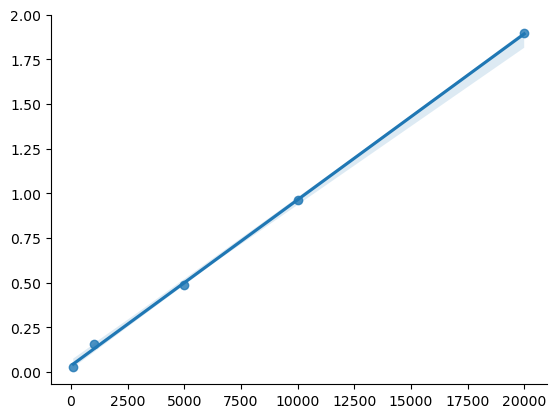

to finish training of our data: 434.75999083434857


In [4]:
from gensim.models import Word2Vec
import scipy
import time

sent_to_iter = [sents[:100], sents[:1000], sents[:5000], sents[:10000], sents[:20000]]

time_to_train = []

for sent in sent_to_iter:
    start_time = time.time()

    model = Word2Vec(sent,
                     **word2vec_params)
    
    elapsed_time = time.time() - start_time
    time_to_train.append(elapsed_time)

p = sns.regplot(x=[100, 1000, 5000, 10000, 20000], 
                y=time_to_train)

slope, intercept, r, p, sterr = scipy.stats.linregress(x=p.get_lines()[0].get_xdata(),
                                                       y=p.get_lines()[0].get_ydata())

sns.despine()
plt.show()

# calculated expected time to finish our data

print('to finish training of our data:', intercept + slope * len(sents))

### Move to Our Real Data

In [5]:
from gensim.models import Word2Vec

model = Word2Vec(sents,                  # tokenized input sentences
                 vector_size=100,        
                 window=2,               
                 sg=1,                   
                 negative=5,             
                 min_count=5,           
                 workers=4,             
                 epochs=3                
                 )

In [8]:
# save the model

os.makedirs('models', exist_ok=True)
model.save('models/anime_w2v_100_2_full.bin')

### Evaluating Diferent Models

As parameter setting will be impacting a lot to the performance of the data, we will play around with setting the parameters and see which one performs better.

    Train and create all model first with all parameters in params_grid

In [9]:
from gensim.models import Word2Vec, FastText

model_path = 'models/'
model_prefix = 'anime'

# create parameter grid, for investigation

params_grid = {'w2v': {'variant': ['cbow', 'sg'],
                       'window': [2, 5, 30]
                       },
              'ft': {'variant': ['sg'],
                       'window': [5]
                       }       
              }

vector_size = 100

for algo, params in params_grid.items():
    
    for variant in params['variant']:
        sg = 1 if variant == 'sg' else 0

        for window in params['window']:
             if algo == 'w2v':
                 model = Word2Vec(sents[:20000],
                                  vector_size=vector_size,
                                  window=window,
                                  sg=sg)
             else:
                  model = FastText(sents[:20000],
                                   vector_size=vector_size,
                                   window=window,
                                   sg=sg)
             
             file_name = f'{model_path}/{model_prefix}_{algo}_{variant}_{window}'   # create the path for our text later
             model.wv.save_word2vec_format(file_name + '.bin', binary=True)         # model.wv -> only save the word vectors, without the model itself, as we're only interested to the word comparison

In [10]:
from gensim.models import KeyedVectors

# load the models we've saved previously

model_list = os.listdir('models/')
model_list.remove('anime_w2v_100_2_full.bin')
models = {}

for file in model_list:
    file_name = 'models/' + file
    model_name = file.replace('.bin', '')

    models[model_name] = KeyedVectors.load_word2vec_format(file_name, binary=True)

In [11]:
model_list

['anime_w2v_sg_30.bin',
 'anime_w2v_cbow_30.bin',
 'anime_w2v_cbow_5.bin',
 'anime_ft_sg_5.bin',
 'anime_w2v_cbow_2.bin',
 'anime_w2v_sg_5.bin',
 'anime_w2v_sg_2.bin']

    Comparing the models

In [12]:
# create a function to see top words with the closest meaning
# by creating a wrapper for gensim.model method

def compare_models(models, **kwargs):

    df = pd.DataFrame()
    for name, model in models:
        df[name] = [f'{word} {score:.3f}' for word, score in model.most_similar(**kwargs)]
    
    df.index = df.index + 1
    return df

In [13]:
# create model list first

model_list = os.listdir('models/')
model_list.remove('anime_w2v_100_2_full.bin')
model_list = list(map(lambda x: x.replace('.bin', ''), model_list))

compare_models([(n, models[n]) for n in model_list], 
               positive='overall', 
               topn=10)

,anime_w2v_sg_30,anime_w2v_cbow_30,anime_w2v_cbow_5,anime_ft_sg_5,anime_w2v_cbow_2,anime_w2v_sg_5,anime_w2v_sg_2
1,enjoyment 0.797,enjoyment 0.951,enjoyment 0.955,910 0.904,enjoyment 0.952,enjoyment 0.879,910 0.885
2,rating 0.786,10 0.950,10 0.925,enjoyment 0.896,9 0.920,510 0.854,score 0.874
3,rated 0.769,9 0.937,9 0.916,410 0.895,910 0.911,910 0.839,9 0.873
4,510 0.762,score 0.925,910 0.913,510 0.887,1010 0.900,thoroughly 0.828,7 0.870
5,misunderstand 0.752,rating 0.916,1010 0.908,score 0.885,810 0.898,score 0.826,1010 0.870
6,210 0.745,1010 0.900,score 0.900,310 0.885,10 0.894,610 0.822,710 0.868
7,verdict 0.742,enjoyable 0.900,810 0.888,610 0.884,7 0.888,rating 0.818,enjoyment 0.868
8,meh 0.742,definitely 0.885,7 0.880,010 0.883,sound 0.880,410 0.815,610 0.864
9,masses 0.739,8 0.878,8 0.873,verdict 0.878,art 0.880,710 0.813,510 0.853
10,410 0.736,art 0.877,enjoyed 0.865,210 0.876,8 0.880,810 0.813,810 0.852


    Warning! 

In this model, there's a lot of things that have to be cleaned up, especially the this 'n'10 because after looking at the data, it's the rating that haven't been preprocessed

## Visualizing Embeddings

### Dimensionality Reduction

As word embeddings works in a really high dimension, we can try to visualize the word embeddings by reducing the dimension into two or three.

There are many different algorithms for dimensionality reduction such as:
- Principal Component Analysis (PCA)
- t-Distributed Stochastic Neighbor Embedding (t-SNE)
- UMAP

For this one now, we're going to use **UMAP**.

---

    Quick Review about (Uniform Manifold Approximation and Projection) UMAP

UMAP works by constructing a low-dimensional representation of the data based on the relationships between the data points in the original high-dimensional space. It leverages concepts from topology and graph theory to create a topological representation of the data, aiming to preserve both local and global structure.

The main advantage of UMAP over other dimensionality reduction techniques, such as PCA and t-SNE, are:
- Its ability to preserve the global structure of the data while still capturing local relationships. 
- It is often considered a powerful alternative to t-SNE, as it can be faster and more suitable for larger datasets.

In [14]:
# load our model again
# load the full one instead of the one we used for comparison

file_name = 'models/anime_w2v_100_2_full.bin'
model = Word2Vec.load(file_name)

model

    Create the Vocab List and it's Weight

In [15]:
import umap.umap_ as UMAP

model = model.wv
words = model.index_to_key  # access the model vocab
wv = [model[word] for word in words]

In [16]:
# pass all the score to umap
# for umap to calculate and reduce the dimensionality

reducer = UMAP.UMAP(n_components=2, 
                    metric='cosine', 
                    n_neighbors=15, 
                    min_dist=0.1)
reduced_wv = reducer.fit_transform(wv)

    Plotting Using Plotly Express

Using Plotly as we're going to plot tens of thousands vocabularies on the plot. So, would be better if we can plot it in an intractive way using Plotly Express.

In [17]:
# plotting directly without any annotation
# showing the proximity of each data point

import plotly.express

plot_df = pd.DataFrame.from_records(reduced_wv, columns=['x', 'y'])
plot_df['word'] = words

params = {'hover_data': {c: False for c in plot_df.columns},
          'hover_name': 'word'}

fig = px.scatter(plot_df, x='x', y='y', opacity=0.3, size_max=3, **params)
fig.update_traces(showlegend=True, legendgroup='Highlighted')

fig.show()

In [19]:
# plotting directly with annotation for some datapoints we're interested to look at

import plotly.express as px

# highlighted words, the words we want to focus on and add annotation into

highlighted_words = ['exciting', 'fun', 'funny']

# column in the dataFrame to indicate whether a word is highlighted
# will be used for the legend later on

plot_df['highlight'] = plot_df['word'].apply(lambda x: x in highlighted_words)

# color mapping for highlighting

color_mapping = {True: 'red', False: 'blue'}

# set the 'color' parameter in the scatter plot

fig = px.scatter(plot_df, x='x', y='y', 
                 opacity=0.1, 
                 size_max=3, 
                 color='highlight',                     # pass the column name with the highlight
                 color_discrete_map=color_mapping,      # color mapping we defined before based on plot_df['highlight']
                 **params)

# Ccstomize the legend title

fig.update_traces(showlegend=False, 
                  legendgroup='Highlighted')

# create highlighted point and it's annotation

highlighted_points = plot_df[plot_df['highlight']]

for i, point in highlighted_points.iterrows():
    fig.add_annotation(
        x=point['x'],
        y=point['y'],
        text=point['word'],
        showarrow=True,
        bgcolor='white',
        arrowhead=1,
        ax=0,
        ay=-30
    )

# Show the plot
fig.show()

    Plotting Using blueprints.embeddings

This is a function that was built by the author of this book, Albrecht et al. (2021). This function is mainly purposed for plot word embedding, thus several advatages are:

- Mainly focused on word embedding purpose.
- Can choose between several dimensional reduction algorithms.

For more detail about this function, visit their page <a href='https://github.com/blueprints-for-text-analytics-python/blueprints-text/tree/master/packages/blueprints'>here.</a>

In [43]:
?plot_embeddings

Signature:
plot_embeddings(
    model,
    search=[],
    topn=0,
    show_all=False,
    train_all=False,
    labels=False,
    colors=True,
    n_dims=2,
    algo='pca',
    **kwargs,
)
Docstring: <no docstring>
File:      ~/Documents/ds_marketing_portfolio/text_analytics/github_repo/embeddings.py
Type:      function

In [45]:
from github_repo.embeddings import plot_embeddings

search = ['naruto', 'bleach', 'gintama']

plot_embeddings(model,
                search=search,
                topn=10,
                show_all=False,
                labels=True,
                algo='umap',
                n_neighbors=15,
                min_dist=10,
                spread=25)

plt.show()

Calculating umap for 26 words ...

/Users/taufiqurrohman/anaconda3/lib/python3.10/site-packages/umap/umap_.py:1356: RuntimeWarning:

divide by zero encountered in power



 done.


## Creating a Similarity Tree

Similarity tree works in a way we're creating a network graph, to see the similarity of each word at each level. We're going to use networx library to create this.

    Little bit introduction about Networkx...

**NetworkX** is a Python library used for the creation, manipulation, and study of the structure, dynamics, and functions of complex networks. It provides an extensive set of tools and functions for working with graphs and networks. With this, we can:

1. Graph Representation: NetworkX provides classes to create and manipulate different types of graphs, such as directed graphs, undirected graphs, and multigraphs. These classes allow you to add nodes, edges, and node/edge attributes to represent real-world networks.

2. Graph Algorithms: NetworkX offers a wide range of graph algorithms to analyze and explore network properties. It includes algorithms for shortest paths, centrality measures, clustering, connectivity, matching, flow algorithms, and more. These algorithms enable you to extract meaningful information from network data and perform various analyses.

3. Visualization: NetworkX provides basic graph drawing and visualization capabilities. It integrates with popular graph visualization tools like Matplotlib and Graphviz to create visual representations of graphs. You can customize the appearance of nodes, edges, and labels to generate informative and visually appealing network visualizations.

4. Network Generation: NetworkX includes functions to generate various types of random networks and well-known network models, such as Erdős-Rényi, Barabási-Albert, and Watts-Strogatz models. These functions allow you to create synthetic networks for experimentation and comparison with real-world networks.

5. Network I/O: NetworkX supports reading and writing graphs in various file formats, including adjacency list, edge list, GML, Pajek, GraphML, and more. This enables you to load network data from external sources and export results for further analysis or sharing.

6. Integration: NetworkX integrates well with other popular scientific libraries in the Python ecosystem, such as NumPy, SciPy, Pandas, and scikit-learn. This allows for seamless integration of graph data with other data structures and analysis tools.

    Loading the Model

In [109]:
# load our model again
# load the full one instead of the one we used for comparison

file_name = 'models/anime_w2v_100_2_full.bin'
model = Word2Vec.load(file_name)
model = model.wv  # convert to word vector

model

    Creating Function to Create the Graph

In [387]:
import networkx as nx
from collections import deque

# create the tree first
# later will be passed to the graph

def sim_tree(model, word, top_n, max_dist):
    '''
    model       : model of the word embedding we've built, pass the wordvector format instead 
    word        : the main word we're interested into
    top_n       : number of maximum edges from each node, top similar nodes to the edge 
    max_dist    : maximum distance, meaning how many levels of nodes
    '''
    graph = nx.Graph()
    graph.add_node(word, dist=0)

    to_visit = deque([word])

    while len(to_visit) > 0:
        source = to_visit.popleft()
        dist = graph.nodes[source]['dist']+1

        if dist <= max_dist:
            for target, sim in model.most_similar(source, topn=top_n):
                if target not in graph:
                    to_visit.append(target)

                    graph.add_node(target, dist=dist)
                    graph.add_edge(source, target, sim=sim, dist=dist)
    
    return graph

In [388]:
from networkx.drawing.nx_pydot import graphviz_layout
import pygraphviz

# function to create the plot from the tree we've built

def plot_tree(graph, node_size=1000, font_size=12):
    '''
    graph       : pass the nx.Graph() object created from sim_tree function
    node_size   : interface needs, node size for the graph
    font_size   : interface needs, font size for the nodes and edges
    '''
    pos = nx.nx_agraph.graphviz_layout(graph, prog='twopi', root=list(graph.nodes)[0])

    colors = [graph.nodes[n]['dist'] for n in graph]

    nx.draw_networkx_nodes(graph, 
                           pos, 
                           node_size=node_size,
                           node_color=colors,
                           cmap='Set1',
                           alpha=0.4)
    
    nx.draw_networkx_labels(graph, 
                            pos, 
                            font_size=font_size)
    
    for (n1, n2, sim) in graph.edges(data='sim'):
        nx.draw_networkx_edges(graph, pos, [(n1, n2)], width=sim, alpha=0.2)

    plt.show()

In [397]:
word='bleach'
top_n=10
max_dist=3

graph = sim_tree(model, word, top_n, max_dist)

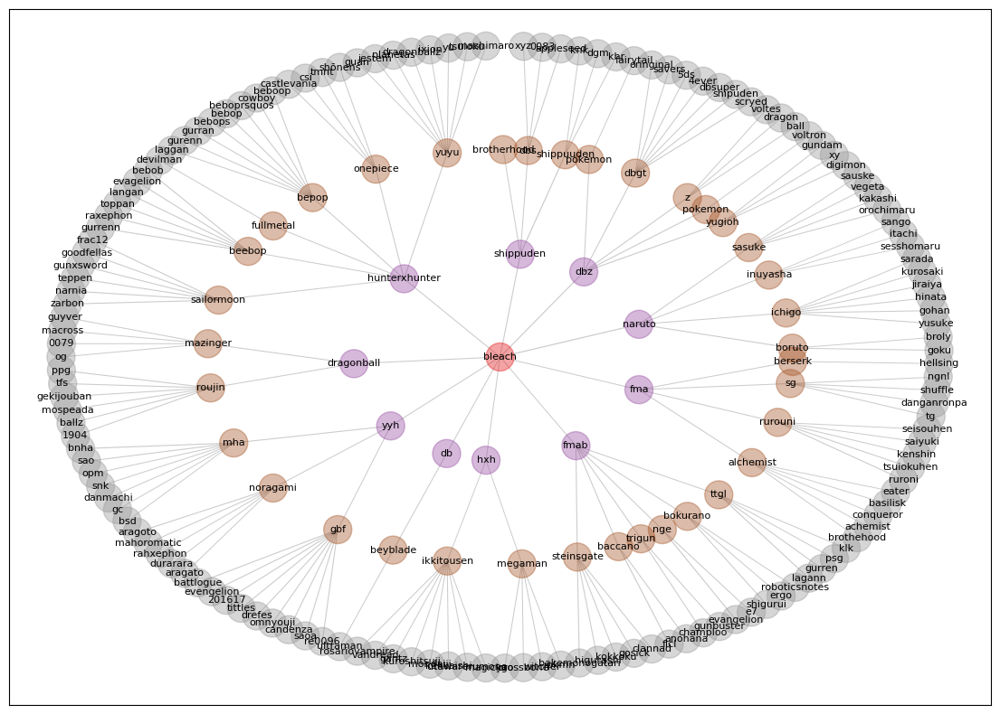

In [398]:
plt.figure(figsize=(14,10))

plot_tree(graph, 
          node_size=500, 
          font_size=8)

plt.show()